## Done
- Web-scraping

## What to do
- EDA

In [105]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import TruncatedSVD, NMF
import warnings
warnings.filterwarnings("ignore")

In [249]:
import matplotlib.pyplot as plt

In [112]:
import spacy
from spacy.symbols import amod
nlp = spacy.load('en_core_web_sm')

In [85]:
from collections import Counter

In [210]:
df = pd.read_csv('data/bgg_top1500_40comment.csv', index_col=0)

In [213]:
df.describe()

,object_id,board_game_rank,year,geek_rating,avg_rating,num_voters,minplayers,maxplayers,playingtime,minplaytime,...,age_10,age_12,age_14,age_16,age_18,age_21,usersrated,owned,numcomments,rating
count,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,...,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,56951.000000,54561.000000
mean,136051.147232,730.244456,2002.364945,6.810649,7.391349,8396.017875,1.867693,4.973925,104.968359,63.205352,...,8.839160,8.806606,5.498341,1.659602,0.311496,0.164387,8396.017875,12394.233446,1694.478218,7.135544
std,94449.482196,431.197411,182.736173,0.415656,0.428090,11314.230230,0.691350,6.146766,351.815339,55.073146,...,15.014996,14.607152,13.292138,5.447151,2.607203,0.660128,11314.230230,16061.672330,1926.322532,1.720924
min,1.000000,1.000000,-3000.000000,6.289000,6.490000,549.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,549.000000,359.000000,165.000000,1.000000
25%,37387.000000,357.000000,2008.000000,6.488000,7.060000,2505.000000,1.000000,4.000000,45.000000,30.000000,...,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,2505.000000,4254.000000,613.000000,6.000000
50%,148943.000000,719.000000,2014.000000,6.720000,7.350000,4374.000000,2.000000,4.000000,60.000000,45.000000,...,5.000000,4.000000,1.000000,0.000000,0.000000,0.000000,4374.000000,6891.000000,1032.000000,7.000000
75%,212445.000000,1099.000000,2017.000000,7.056000,7.680000,9317.000000,2.000000,5.000000,120.000000,75.000000,...,10.000000,10.000000,5.000000,1.000000,0.000000,0.000000,9317.000000,13158.000000,1997.000000,8.000000
max,329465.000000,1500.000000,2021.000000,8.523000,8.870000,107113.000000,8.000000,100.000000,12000.000000,720.000000,...,203.000000,206.000000,163.000000,88.000000,90.000000,10.000000,107113.000000,164578.000000,19153.000000,10.000000


In [211]:
df_stat = pd.read_csv('data/top_1500_stat.csv', index_col=0)
df_stat

,object_id,year,minplayers,maxplayers,playingtime,minplaytime,maxplaytime,age,age_2,age_3,...,age_8,age_10,age_12,age_14,age_16,age_18,age_21,usersrated,owned,numcomments
0,174430,2017,1,4,120,60,120,14,4,0,...,5,41,80,127,17,2,3,46322,75130,8322
1,161936,2015,2,4,60,60,60,13,1,1,...,18,44,62,25,7,0,1,44096,69073,6684
2,224517,2018,2,4,120,60,120,14,1,0,...,4,6,19,40,13,0,1,23895,35630,3624
3,167791,2016,1,5,120,120,120,12,0,0,...,18,76,123,68,5,2,3,71631,97632,10473
4,291457,2020,1,4,120,30,120,14,0,0,...,5,15,31,24,1,1,0,14046,33682,2161
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1495,104955,2012,2,2,75,75,75,13,0,0,...,0,3,6,1,0,0,0,1692,2239,492
1496,6205,2003,2,3,720,720,720,14,0,0,...,1,0,2,3,6,1,0,1280,2336,673
1497,273703,2020,1,4,90,30,90,14,0,0,...,0,3,4,1,0,0,0,927,2411,319
1498,730,1992,2,2,240,240,240,12,0,0,...,0,1,2,2,3,0,1,1006,2260,529


In [212]:
df_stat.describe()

,object_id,year,minplayers,maxplayers,playingtime,minplaytime,maxplaytime,age,age_2,age_3,...,age_8,age_10,age_12,age_14,age_16,age_18,age_21,usersrated,owned,numcomments
count,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,...,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000,1500.000000
mean,139470.713333,2002.893333,1.864667,4.960667,105.020000,62.296667,105.020000,11.395333,0.063333,0.140667,...,8.038000,8.494000,8.416667,5.176667,1.582667,0.297333,0.156000,8059.608000,11963.864667,1628.106000
std,95066.747096,178.260577,0.692824,6.038827,363.649473,54.705683,363.649473,2.325220,0.407553,1.614089,...,18.449159,14.683745,14.202495,12.614577,5.306908,2.542421,0.641824,11067.377527,15667.833580,1889.169917
min,1.000000,-3000.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,549.000000,359.000000,165.000000
25%,39253.250000,2009.000000,1.000000,4.000000,45.000000,30.000000,45.000000,10.000000,0.000000,0.000000,...,0.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,2411.750000,4125.500000,571.000000
50%,154144.500000,2014.000000,2.000000,4.000000,60.000000,45.000000,60.000000,12.000000,0.000000,0.000000,...,2.000000,4.500000,4.000000,1.000000,0.000000,0.000000,0.000000,4139.500000,6608.000000,987.000000
75%,217800.250000,2017.000000,2.000000,5.000000,120.000000,60.000000,120.000000,13.000000,0.000000,0.000000,...,8.000000,10.000000,9.000000,5.000000,1.000000,0.000000,0.000000,8934.750000,12744.500000,1910.000000
max,329465.000000,2021.000000,8.000000,100.000000,12000.000000,720.000000,12000.000000,18.000000,9.000000,44.000000,...,280.000000,203.000000,206.000000,163.000000,88.000000,90.000000,10.000000,107113.000000,164578.000000,19153.000000


In [214]:
df_game = df.groupby(['object_id','board_game_rank']).agg({'comment': '/n'.join}).reset_index()

In [257]:
df_game

,object_id,board_game_rank,comment,spacy_doc,docs_clean
0,1,312,"Components: if you have the Moskito edition, t...","(Components, :, if, you, have, the, Moskito, e...","[component, moskito, edition, good, \n, comple..."
1,3,224,"2017-02-18 - 7,5 - Simple rules, quick gamepla...","(2017, -, 02, -, 18, -, 7,5, -, Simple, rules,...","[simple, rule, quick, gameplay, easy, teach, p..."
2,5,286,The first time I played this at a friend's hou...,"(The, first, time, I, played, this, at, a, fri...","[time, play, friend, house, feel, like, sweep,..."
3,10,1112,"Elfenland spielt in einer Fantasiewelt, in der...","(Elfenland, spielt, in, einer, Fantasiewelt, ,...","[elfenland, spielt, einer, fantasiewelt, der, ..."
4,11,464,Played a full 7 players the one time I played ...,"(Played, a, full, 7, players, the, one, time, ...","[play, player, time, play, feel, random, engag..."
...,...,...,...,...,...
1495,319966,599,I was quite harsh in my rating and comments ab...,"(I, was, quite, harsh, in, my, rating, and, co...","[harsh, rating, comment, king, siam, appear, ..."
1496,322708,999,"I was skeptical when I first got it, but after...","(I, was, skeptical, when, I, first, got, it, ,...","[skeptical, get, , quest, game, , app, wonde..."
1497,324856,625,An improvement over the original (which was al...,"(An, improvement, over, the, original, (, whic...","[improvement, original, fantastic, , like, mi..."
1498,328871,561,Prettier production but even worse than the or...,"(Prettier, production, but, even, worse, than,...","[prettier, production, bad, original, game, ph..."


In [244]:
length = []
for i in range(1500):
    length.append(len(df_game.loc[i,'comment']))
np.mean(length)

36556.07

(array([ 11.,  89., 225., 737., 331.,  87.,  13.,   6.,   0.,   1.]),
 array([ 1885. , 11578.9, 21272.8, 30966.7, 40660.6, 50354.5, 60048.4,
        69742.3, 79436.2, 89130.1, 98824. ]),
 <BarContainer object of 10 artists>)

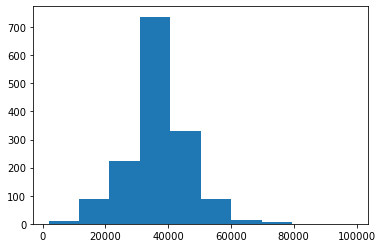

In [253]:
plt.hist(length)

In [254]:
np.max(length)

98824

In [248]:
np.min(length)

1885

In [216]:
len(df.loc[3,'comment'])

645

In [217]:
df

,object_id,alias,board_game_rank,title,year,geek_rating,avg_rating,num_voters,minplayers,maxplayers,...,age_14,age_16,age_18,age_21,usersrated,owned,numcomments,username,rating,comment
0,174430,gloomhaven,1,Gloomhaven,2017,8.523,8.76,46322,1,4,...,127,17,2,3,46322,75130,8322,Kvothe1981,10.0,Es buenísimo. Si juntas el jugo de Baldur´s Ga...
1,174430,gloomhaven,1,Gloomhaven,2017,8.523,8.76,46322,1,4,...,127,17,2,3,46322,75130,8322,Kylesussenbach,8.0,"Pros - Brilliant combat design, unique charact..."
2,174430,gloomhaven,1,Gloomhaven,2017,8.523,8.76,46322,1,4,...,127,17,2,3,46322,75130,8322,kytah,NaN,"Look for it, and grab it when you can!\n\nGloo..."
3,174430,gloomhaven,1,Gloomhaven,2017,8.523,8.76,46322,1,4,...,127,17,2,3,46322,75130,8322,l0g0n,10.0,"When I ordered Gloomhaven, I thought it looked..."
4,174430,gloomhaven,1,Gloomhaven,2017,8.523,8.76,46322,1,4,...,127,17,2,3,46322,75130,8322,Lagomorph,8.9,Surprisingly challenging tactical combat game ...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56946,206940,carcassonne-amazonas,1500,Carcassonne: Amazonas,2016,6.289,7.09,1694,2,5,...,0,0,0,0,1694,3725,341,darquil,6.0,Components: Looks great. Right up there with H...
56947,206940,carcassonne-amazonas,1500,Carcassonne: Amazonas,2016,6.289,7.09,1694,2,5,...,0,0,0,0,1694,3725,341,durkinphd,9.0,Another very nice variation of Carcassonne. Th...
56948,206940,carcassonne-amazonas,1500,Carcassonne: Amazonas,2016,6.289,7.09,1694,2,5,...,0,0,0,0,1694,3725,341,EmpressGeek,2.0,"[b]Rating based on - 5 plays, 2 player[/b]\nCa..."
56949,206940,carcassonne-amazonas,1500,Carcassonne: Amazonas,2016,6.289,7.09,1694,2,5,...,0,0,0,0,1694,3725,341,ericlosiewicz,8.5,Fantastic new implementation of Carcassonne. ...


In [218]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 56951 entries, 0 to 56950
Data columns (total 32 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   object_id        56951 non-null  int64  
 1   alias            56951 non-null  object 
 2   board_game_rank  56951 non-null  int64  
 3   title            56951 non-null  object 
 4   year             56951 non-null  int64  
 5   geek_rating      56951 non-null  float64
 6   avg_rating       56951 non-null  float64
 7   num_voters       56951 non-null  int64  
 8   minplayers       56951 non-null  int64  
 9   maxplayers       56951 non-null  int64  
 10  playingtime      56951 non-null  int64  
 11  minplaytime      56951 non-null  int64  
 12  maxplaytime      56951 non-null  int64  
 13  age              56951 non-null  int64  
 14  age_2            56951 non-null  int64  
 15  age_3            56951 non-null  int64  
 16  age_4            56951 non-null  int64  
 17  age_5       

In [219]:
df.loc[0, 'comment']

'Es buenísimo. Si juntas el jugo de Baldur´s Gate, el juego de Shigning Force II, un librojuego y el ajedrez y da como resultado el Gloomhaven. \n\nEspectacular. (Mi favorito junto a el Señor de los Anillos, Viajes por la Tierra Media). En solitario jugando con 3 jugadores es una delicia. \n\nNo se porqué, pero sus personajes se adaptan bien a muchas novelas de narrativa fantástica (sobre todo libros de Brandon Sanderson, como Nacidos de la Bruma y el Archivo de las Tormentas). \n\nUna de las cosas que también me encantan es su misterio, con muchas cosas ocultas y su cantidad de escenario. (Llevo jugando 6 meses y aún n he terminado el juego y me sigue gustando y sorprendiendo con cada personaje y escenario).'

In [256]:
df.loc[56950, 'comment']

'Az alap Carcassonne mechanizmus azzal bővül, hogy mindenki kap egy csónak figurát is, ami az épülő nagy folyón halad lefelé és ott gyűjt plusz pontokat. Ha olyan lapkát húz a játékos, amit a nagy folyóhoz kell illesztenie, akkor pontot szerez az élen haladó és a második játékos, az utolsó pedig csökkentheti a lemaradását. A folyón előre lépni pedig kétféle esetben lehet. Ha nem tettünk sem figurát sem tábort (ez a paraszt funkcióját tölti be), akkor 1 lépést tehetünk a folyón a csónakkal. Akár több lépést is megtehetünk ugyanott, ha valamelyik mellékfolyón álló figuránk a lapkákon szereplő csónak-jelekkel kerül összeköttetésbe. \nMivel 22 folyó lapka minden játékban lekerül az asztalra egy egyenes sor mentén, ezért csak olyan helyen érdemes elkezdeni, ahol ez a kb. 1 méter a rendelkezésre áll.\nA játék hevében mindenki egymást előzgeti és az élre akar kerülni a csónakjával, pedig a tábla más részein is vannak értékes pontok.'

In [220]:
df.loc[1, 'comment']

'Pros - Brilliant combat design, unique characterization and advancement, great cooperative play.\nCons - Mediocre story, disappointing item design, repetitive scenarios. Massive Setup and maintenance. \n\nI started out loving Gloomhaven and usually find something to enjoy with each play session, but monsters almost always feel the same and some of the mechanics are very gamey. From time to time a scenario really brings new life back into the game, and opening up a new character is always thrilling.\n\n2020 Update: I\'ve lowered my score for this game as time has worn off the "newness." It is still great, but my groups never want to play it because of the incredible setup/play time. The last time we pulled it out, we duo\'d a scenario and it was over 4 hours of setup, play, and clean up.'

In [27]:
doc = nlp(df.loc[1, 'comment'])
doc

Pros - Brilliant combat design, unique characterization and advancement, great cooperative play.
Cons - Mediocre story, disappointing item design, repetitive scenarios. Massive Setup and maintenance. 

I started out loving Gloomhaven and usually find something to enjoy with each play session, but monsters almost always feel the same and some of the mechanics are very gamey. From time to time a scenario really brings new life back into the game, and opening up a new character is always thrilling.

2020 Update: I've lowered my score for this game as time has worn off the "newness." It is still great, but my groups never want to play it because of the incredible setup/play time. The last time we pulled it out, we duo'd a scenario and it was over 4 hours of setup, play, and clean up.

In [28]:
for token in doc:
    print(token.text, token.pos_, token.lemma_, token.is_stop)

Pros PROPN Pros False
- ADJ - False
Brilliant ADJ brilliant False
combat NOUN combat False
design NOUN design False
, PUNCT , False
unique ADJ unique False
characterization NOUN characterization False
and CCONJ and True
advancement NOUN advancement False
, PUNCT , False
great ADJ great False
cooperative ADJ cooperative False
play NOUN play False
. PUNCT . False

 SPACE 
 False
Cons PROPN Cons False
- PUNCT - False
Mediocre PROPN Mediocre False
story NOUN story False
, PUNCT , False
disappointing ADJ disappointing False
item NOUN item False
design NOUN design False
, PUNCT , False
repetitive ADJ repetitive False
scenarios NOUN scenario False
. PUNCT . False
Massive PROPN Massive False
Setup PROPN Setup False
and CCONJ and True
maintenance NOUN maintenance False
. PUNCT . False


 SPACE 

 False
I PRON I True
started VERB start False
out ADP out True
loving VERB love False
Gloomhaven PROPN Gloomhaven False
and CCONJ and True
usually ADV usually False
find VERB find False
something PRON s

In [37]:
for idx, sent in enumerate(doc.sents):
    print(str(idx)+":", sent)

0: Pros - Brilliant combat design, unique characterization and advancement, great cooperative play.
1: 
Cons - Mediocre story, disappointing item design, repetitive scenarios.
2: Massive Setup and maintenance.
3: 

I started out loving Gloomhaven and usually find something to enjoy with each play session, but monsters almost always feel the same and some of the mechanics are very gamey.
4: From time to time a scenario really brings new life back into the game, and opening up a new character is always thrilling.
5: 

2020 Update: I've lowered my score for this game as time has worn off the "newness.
6: " It is still great, but my groups never want to play it because of the incredible setup/play time.
7: The last time we pulled it out, we duo'd a scenario and it was over 4 hours of setup, play, and clean up.


In [38]:
for token in doc:
    print(token.text, token.dep_)

Pros amod
- punct
Brilliant amod
combat compound
design ROOT
, punct
unique amod
characterization conj
and cc
advancement conj
, punct
great amod
cooperative amod
play conj
. punct

 nmod
Cons compound
- punct
Mediocre compound
story ROOT
, punct
disappointing amod
item compound
design conj
, punct
repetitive amod
scenarios conj
. punct
Massive compound
Setup ROOT
and cc
maintenance conj
. punct


 dep
I nsubj
started ROOT
out prt
loving xcomp
Gloomhaven dobj
and cc
usually advmod
find conj
something dobj
to aux
enjoy relcl
with prep
each det
play compound
session pobj
, punct
but cc
monsters nsubj
almost advmod
always advmod
feel conj
the det
same attr
and cc
some nsubj
of prep
the det
mechanics pobj
are conj
very advmod
gamey acomp
. punct
From prep
time pobj
to prep
time pobj
a det
scenario nsubj
really advmod
brings ROOT
new amod
life dobj
back advmod
into prep
the det
game pobj
, punct
and cc
opening csubj
up prt
a det
new amod
character dobj
is aux
always advmod
thrilling conj
. 

In [50]:
spacy.displacy.render(doc, style='dep', options={'distance': 80})

In [117]:
for token in doc:
    if token.dep_ == 'amod':
        print(f"ADJ MODIFIER: {token.text} --> NOUN: {token.head}")

ADJ MODIFIER: Pros --> NOUN: design
ADJ MODIFIER: Brilliant --> NOUN: design
ADJ MODIFIER: unique --> NOUN: characterization
ADJ MODIFIER: great --> NOUN: play
ADJ MODIFIER: cooperative --> NOUN: play
ADJ MODIFIER: disappointing --> NOUN: design
ADJ MODIFIER: repetitive --> NOUN: scenarios
ADJ MODIFIER: new --> NOUN: life
ADJ MODIFIER: new --> NOUN: character
ADJ MODIFIER: incredible --> NOUN: setup
ADJ MODIFIER: last --> NOUN: time


In [52]:
for ent in doc.ents:
    print(ent.text, ent.label_)

Cons - Mediocre ORG
Massive Setup PERSON
Gloomhaven ORG
4 hours TIME


In [55]:
spacy.displacy.render(doc, style='ent', jupyter=True)

## Clean

In [221]:
docs = list(nlp.pipe(df_game.comment))
df_game['spacy_doc'] = docs
df_game['spacy_doc']

0       (Components, :, if, you, have, the, Moskito, e...
1       (2017, -, 02, -, 18, -, 7,5, -, Simple, rules,...
2       (The, first, time, I, played, this, at, a, fri...
3       (Elfenland, spielt, in, einer, Fantasiewelt, ,...
4       (Played, a, full, 7, players, the, one, time, ...
                              ...                        
1495    (I, was, quite, harsh, in, my, rating, and, co...
1496    (I, was, skeptical, when, I, first, got, it, ,...
1497    (An, improvement, over, the, original, (, whic...
1498    (Prettier, production, but, even, worse, than,...
1499    (Not, sure, that, the, additions, to, the, Fan...
Name: spacy_doc, Length: 1500, dtype: object

In [222]:
docs_clean = [[w.lemma_.lower() for w in doc if (not w.is_stop and not w.is_punct and not w.like_num) \
               or (w.lemma_=='not')] for doc in docs]
df_game['docs_clean'] = docs_clean

In [223]:
docs_list_clean = [' '.join(doc) for doc in docs_clean]

In [224]:
docs_list_clean

["component moskito edition good \n complex hard master difficult learn \n weight heavy \n players \n length hour \n mechanic bidding area control \n decision lot \n opinion pleasure play game die macher theme run away gameplay delicious \n master political party win election decide ländern keep eye national board \n rule not hard learn difficult start play connected game easy understand \n play round play länder prepare future situation prepare politic party versus current länder take care national board game end decide need money private donation bid different survey not help avoid mess plan vote different election \n length game hour pass fast time turn round lot phase fast make player participate time \n talk good thing game long time finish say favorite game pleasure play occasion look play soon ndie macher good game not nirvana orgasm holy grand poobah gaming   astonishing game time hold   play shock huge role luck play opinion poll especially regional issue   not expect game por

In [225]:
cv = TfidfVectorizer(stop_words='english', max_df=0.8, min_df=0.05)
X = cv.fit_transform(docs_list_clean)

df_X = pd.DataFrame(X.toarray(), columns=cv.get_feature_names())
df_X.head()

,01,02,03,04,05,06,07,08,09,10,...,zur,zwei,én,érdeke,érzem,és,être,így,úgy,über
0,0.0,0.0,0.025335,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000
1,0.0,0.0,0.016467,0.000000,0.01663,0.0,0.0,0.032775,0.000000,0.010131,...,0.00000,0.000000,0.0,0.0,0.0,0.010350,0.0,0.000000,0.000000,0.000000
2,0.0,0.0,0.000000,0.032226,0.00000,0.0,0.0,0.031676,0.063351,0.009791,...,0.00000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000
3,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.014744,0.000000,0.009115,...,0.01612,0.014963,0.0,0.0,0.0,0.027936,0.0,0.012104,0.014029,0.015927
4,0.0,0.0,0.000000,0.000000,0.00000,0.0,0.0,0.000000,0.000000,0.000000,...,0.00000,0.000000,0.0,0.0,0.0,0.086754,0.0,0.075177,0.065350,0.000000


## Parts of Speech by Sentiment

In [226]:
df_rating = df_game.merge(df[['object_id', 'geek_rating']], on='object_id').drop_duplicates(subset='object_id').reset_index()

In [227]:
df_rating

,index,object_id,board_game_rank,comment,spacy_doc,docs_clean,geek_rating
0,0,1,312,"Components: if you have the Moskito edition, t...","(Components, :, if, you, have, the, Moskito, e...","[component, moskito, edition, good, \n, comple...",7.104
1,40,3,224,"2017-02-18 - 7,5 - Simple rules, quick gamepla...","(2017, -, 02, -, 18, -, 7,5, -, Simple, rules,...","[simple, rule, quick, gameplay, easy, teach, p...",7.240
2,80,5,286,The first time I played this at a friend's hou...,"(The, first, time, I, played, this, at, a, fri...","[time, play, friend, house, feel, like, sweep,...",7.143
3,120,10,1112,"Elfenland spielt in einer Fantasiewelt, in der...","(Elfenland, spielt, in, einer, Fantasiewelt, ,...","[elfenland, spielt, einer, fantasiewelt, der, ...",6.479
4,160,11,464,Played a full 7 players the one time I played ...,"(Played, a, full, 7, players, the, one, time, ...","[play, player, time, play, feel, random, engag...",6.934
...,...,...,...,...,...,...,...
1495,56763,319966,599,I was quite harsh in my rating and comments ab...,"(I, was, quite, harsh, in, my, rating, and, co...","[harsh, rating, comment, king, siam, appear, ...",6.800
1496,56803,322708,999,"I was skeptical when I first got it, but after...","(I, was, skeptical, when, I, first, got, it, ,...","[skeptical, get, , quest, game, , app, wonde...",6.537
1497,56843,324856,625,An improvement over the original (which was al...,"(An, improvement, over, the, original, (, whic...","[improvement, original, fantastic, , like, mi...",6.786
1498,56871,328871,561,Prettier production but even worse than the or...,"(Prettier, production, but, even, worse, than,...","[prettier, production, bad, original, game, ph...",6.836


In [228]:
df_rating.describe()

,index,object_id,board_game_rank,geek_rating
count,1500.000000,1500.000000,1500.000000,1500.000000
mean,29051.838667,139470.713333,750.500000,6.792886
std,16553.809420,95066.747096,433.157015,0.410918
min,0.000000,1.000000,1.000000,6.289000
25%,14754.000000,39253.250000,375.750000,6.468000
50%,29291.000000,154144.500000,750.500000,6.694000
75%,43506.000000,217800.250000,1125.250000,7.033500
max,56911.000000,329465.000000,1500.000000,8.523000


In [231]:
positive_reviews = df_rating[df_rating.geek_rating>=6.7]
negative_reviews = df_rating[df_rating.geek_rating<6.7]

In [232]:
print((len(positive_reviews), len(negative_reviews)))

(743, 757)


In [233]:
pos_adj = [token.text.lower() for doc in positive_reviews.spacy_doc for token in doc if token.pos_=='ADJ']
neg_adj = [token.text.lower() for doc in negative_reviews.spacy_doc for token in doc if token.pos_=='ADJ']

pos_noun = [token.text.lower() for doc in positive_reviews.spacy_doc for token in doc if token.pos_=='NOUN']
neg_noun = [token.text.lower() for doc in negative_reviews.spacy_doc for token in doc if token.pos_=='NOUN']

In [234]:
Counter(pos_adj).most_common(10)

[('more', 13755),
 ('other', 11485),
 ('good', 10971),
 ('great', 8183),
 ('different', 7849),
 ('many', 7166),
 ('first', 6822),
 ('interesting', 6075),
 ('little', 5930),
 ('new', 5666)]

In [235]:
Counter(pos_noun).most_common(10)

[('game', 93908),
 ('cards', 19562),
 ('players', 16943),
 ('games', 16149),
 ('player', 15278),
 ('time', 12390),
 ('card', 9780),
 ('lot', 7902),
 ('play', 7885),
 ('rules', 7550)]

In [236]:
Counter(neg_adj).most_common(10)

[('more', 11826),
 ('other', 10275),
 ('good', 9644),
 ('different', 6606),
 ('great', 6589),
 ('many', 5859),
 ('first', 5747),
 ('little', 5707),
 ('interesting', 5657),
 ('much', 4726)]

In [237]:
Counter(neg_noun).most_common(10)

[('game', 80974),
 ('cards', 18105),
 ('players', 15955),
 ('player', 14279),
 ('games', 12948),
 ('time', 10233),
 ('card', 9633),
 ('rules', 7470),
 ('play', 6580),
 ('lot', 6440)]

## Dependency Parsing

In [198]:
def get_amods(noun, ser):
    amod_list = []
    for doc in ser:
        for token in doc:
            if (token.text) == noun:
                for child in token.children:
                    if child.dep == amod:
                        amod_list.append(child.text.lower())
    return sorted(amod_list)

def amods_by_sentiment(noun):
    print(f"Adjectives describing {str.upper(noun)}:\n")
    
    print("POSITIVE:")
    print(get_amods(noun, positive_reviews.spacy_doc))
    
    print("\nNEGATIVE:")
    print(get_amods(noun, negative_reviews.spacy_doc))

In [255]:
amods_by_sentiment("games")

Adjectives describing GAMES:

POSITIVE:
['-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-player', '10ish', '10ish', '15min', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '1st', '1st', '1st', '1st', '1st', '2pl', '50ish', '51st', 'above', 'above', 'above', 'absolute', 'absolute

['+', '+', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '-', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '18xx', '4th', 'absolute', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'abstract', 'a

## Topic Modeling - NMF

In [239]:
topics = NMF(20)
doc_topic = topics.fit_transform(X)

In [240]:

topic_word = pd.DataFrame(topics.components_.round(3),
             columns = cv.get_feature_names())
topic_word

,01,02,03,04,05,06,07,08,09,10,...,zur,zwei,én,érdeke,érzem,és,être,így,úgy,über
0,0.034,0.025,0.021,0.026,0.000,0.016,0.011,0.030,0.013,0.054,...,0.000,0.005,0.003,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,0.000,0.000,0.000,0.001,0.001,0.004,0.003,0.001,0.005,0.014,...,0.000,0.000,0.000,0.000,0.000,0.000,0.005,0.000,0.003,0.000
2,0.006,0.003,0.004,0.007,0.005,0.008,0.010,0.004,0.010,0.009,...,0.000,0.000,0.000,0.002,0.000,0.021,0.000,0.005,0.000,0.000
3,0.003,0.004,0.001,0.002,0.004,0.004,0.007,0.004,0.000,0.006,...,0.000,0.000,0.000,0.002,0.000,0.000,0.000,0.000,0.000,0.000
4,0.002,0.008,0.006,0.005,0.002,0.000,0.000,0.000,0.005,0.000,...,0.066,0.113,0.000,0.001,0.000,0.000,0.005,0.000,0.000,0.070
5,0.005,0.004,0.000,0.003,0.000,0.000,0.000,0.000,0.003,0.009,...,0.001,0.000,0.000,0.006,0.003,0.000,0.000,0.000,0.000,0.001
6,0.009,0.001,0.000,0.004,0.004,0.008,0.012,0.014,0.010,0.019,...,0.000,0.000,0.000,0.000,0.001,0.000,0.000,0.000,0.000,0.001
7,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.007,...,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
8,0.007,0.001,0.000,0.004,0.013,0.001,0.005,0.000,0.003,0.013,...,0.000,0.000,0.000,0.000,0.001,0.003,0.000,0.000,0.001,0.000
9,0.009,0.004,0.020,0.006,0.010,0.009,0.002,0.000,0.000,0.013,...,0.000,0.000,0.000,0.000,0.000,0.000,0.052,0.000,0.000,0.008


In [241]:
def display_topics(model, feature_names, no_top_words, topic_names=None):
    for ix, topic in enumerate(model.components_):
        if not topic_names or not topic_names[ix]:
            print("\nTopic ", ix)
        else:
            print("\nTopic: '",topic_names[ix],"'")
        print(", ".join([feature_names[i]
                        for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [242]:
display_topics(topics, cv.get_feature_names(), 10)


Topic  0
hand, nostar, scoring, trick, score, round, draw, filler, drafting, animal

Topic  1
star, nostar, size, halfstar, x2, 5x, thumbsup, mechanics, 2x, weight

Topic  2
tile, carcassonne, scoring, lay, score, city, placement, bonus, meeple, building

Topic  3
dice, roll, die, rolling, color, solo, write, expansion, team, light

Topic  4
und, der, die, das, ist, zu, ich, ein, spiel, auf

Topic  5
worker, placement, resource, action, building, round, agricola, euro, meeple, spot

Topic  6
unit, war, wargame, battle, combat, scenario, army, map, historical, attack

Topic  7
monster, dungeon, hero, quest, crawl, crawler, boss, miniature, enemy, treasure

Topic  8
deck, dominion, building, builder, expansion, deckbuilder, magic, draw, hand, build

Topic  9
que, la, en, el, juego, es, los, se, et, las

Topic  10
auction, bid, bidding, money, round, blind, knizia, value, market, economic

Topic  11
ship, alien, planet, space, captain, crew, fleet, mission, boat, merchant

Topic  12
puzz

## Topic Modeling  - ISA